In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import igraph as ig
import decoupler as dc
import matplotlib.pyplot as plt
from datetime import datetime
from scipy.sparse import csr_matrix, isspmatrix

import scanpy as sc
import scanpy.external as sce

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=80)
time_start = datetime.now()
print(time_start)

2024-01-19 02:58:11.703173


In [3]:
import sys
sys.path.append('../..')

from src.configs import config
from src.utils import utils as us
from src.utils import visualise as vs
%load_ext autoreload
%autoreload 2
# warnings.filterwarnings("once")distances

# Data Load

In [4]:
adata = sc.read(config.PATHS.LOGS/'Norm.h5ad')
print('isspmatrix:', isspmatrix(adata.X))


print('Loaded Filtered AnnData object: number of cells', adata.n_obs)
print('Loaded Filtered AnnData object: number of genes', adata.n_vars) 
print('Available metadata for each cell: ', adata.obs.columns)

isspmatrix: True
Loaded Filtered AnnData object: number of cells 39346
Loaded Filtered AnnData object: number of genes 14708
Available metadata for each cell:  Index(['timepoint', 'line', 'tSNE_1', 'tSNE_2', 'cluster', 'timepoint_mapped',
       'batch', 'dataset', 'isHuman', 'isESC', 'n_genes_by_counts',
       'total_counts', 'total_counts_mito', 'pct_counts_mito',
       'total_counts_ribo', 'pct_counts_ribo', 'QC_doublets', 'n_genes',
       'n_counts'],
      dtype='object')


In [5]:
if config.PROTO.SUBSET.USE_HIGHLY_VARIABLE:
    adata = adata[:, adata.var.highly_variable]
adata.obs['cluster_ematb'] = adata.obs.cluster.apply(
    lambda x: x if 'C' == x[0] else 'N')

# Check for batch effects

In [ ]:
adata_check = adata.copy()

sc.pp.normalize_total(adata_check, target_sum=1e6)
sc.pp.log1p(adata_check)
sc.pp.scale(adata_check, max_value=10)

sc.pp.pca(
    adata_check, n_comps=10, use_highly_variable=True,
    svd_solver='arpack')
sc.pp.neighbors(adata_check, n_neighbors=30, n_pcs=10)

## LDA

In [ ]:
import sklearn
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

# pca = PCA(n_components=4)
# pca.fit(
#     adata_check.X, adata_check.obs.line)

model = LinearDiscriminantAnalysis(n_components=4)
adata_check.obsm['X_pca'] = model.fit_transform(
    adata_check.X, adata_check.obs.line)

In [ ]:
sc.pp.neighbors(adata_check, n_neighbors=30, n_pcs=4)
sc.tl.umap(adata_check)

sc.pl.umap(adata_check, color=['line', 'cluster'], alpha=1.)
fig.savefig(config.PATHS.APPENDIX/'umap_lda_wbatch')
# us.log('', 'umap_{}_wbatch'.format(key))

## ANOVA

In [12]:
adata_check.obs['tp'] = adata_check.obs.timepoint_mapped.apply(
    lambda x: 'd{}'.format(x))

dc.get_metadata_associations(
    adata_check,
    #metadata columns to associate to PCs
    obs_keys = ['line', 'cluster', 'tp'],
    obsm_key='X_pca',  # where the PCs are stored
    uns_key='pca_anova',  # where the results are stored
    inplace=True
)

100%|██████████| 4/4 [00:01<00:00,  3.25it/s]


In [17]:
tmp = adata_check.uns['pca_anova']
for k in ['p_adj', 'pval']:
    pmin = tmp[tmp[k] != 0][k].min()
    adata_check.uns['pca_anova'][k] = tmp[k].apply(
        lambda x: x if x !=0 else pmin)

In [14]:
adata_check

AnnData object with n_obs × n_vars = 27809 × 5000
    obs: 'timepoint', 'line', '10X_date', 'clusters', 'tSNE_1', 'tSNE_2', 'cluster', 'timepoint_mapped', 'batch', 'dataset', 'isHuman', 'isESC', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'pct_counts_ribo', 'QC_doublets', 'n_genes', 'n_counts', 'cluster_ematb', 'tp'
    var: 'mito', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'triku_distance', 'triku_distance_uncorrected', 'triku_highly_variable', 'mean', 'std'
    uns: 'line_colors', 'log1p', 'neighbors', 'pca', 'umap', 'cluster_colors', 'pca_anova'
    obsm: 'X_pca', 'X_triku', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'lognormcounts'
    obsp: 'connectivities', 'distances'

In [18]:
adata_check.uns['pca_anova']

,variable,pval,eta_sq,factor,p_adj
0,line,2.477988e-242,0.946753,PC1,2.477988e-242
1,cluster,2.477988e-242,0.040241,PC1,2.477988e-242
2,tp,2.477988e-242,0.230219,PC1,2.477988e-242
3,line,2.477988e-242,0.928467,PC2,2.477988e-242
4,cluster,2.477988e-242,0.248362,PC2,2.477988e-242
5,tp,2.477988e-242,0.253919,PC2,2.477988e-242
6,line,2.477988e-242,0.859721,PC3,2.477988e-242
7,cluster,2.477988e-242,0.116674,PC3,2.477988e-242
8,tp,1.440730e-108,0.017906,PC3,1.440730e-108
9,line,2.477988e-242,0.752580,PC4,2.477988e-242


In [20]:
import PyComplexHeatmap 

In [21]:
PyComplexHeatmap.DendrogramPlotter()

PyComplexHeatmap.clustermap.DendrogramPlotter

Starting plotting HeatmapAnnotations


ValueError: The condensed distance matrix must contain only finite values.

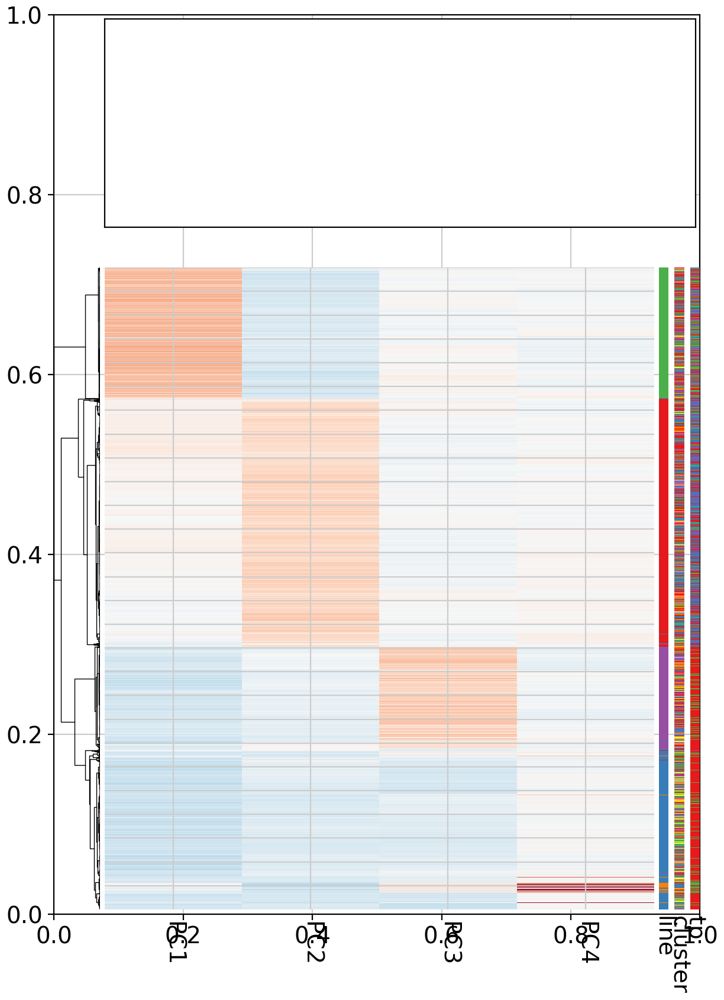

In [19]:
plt.figure(figsize=(7,10))
ax, legend_axes = dc.plot_associations(
    adata_check,
    uns_key='pca_anova',  # summary statistics from the anova tests
    obsm_key='X_pca',  # where the PCs are stored
    stat_col='p_adj',  # which summary statistic to plot
    obs_annotation_cols = ['line', 'cluster', 'tp'], # which sample annotations to plot
    titles=['Adjusted p-values from ANOVA', 'Principle component scores']
)
plt.show()

In [22]:
tmp = pd.crosstab(
    adata.obs['cluster'], adata.obs['timepoint_mapped'])
tmp / tmp.sum(0)

timepoint_mapped,5,14,28,35
cluster,,,,
C1,0.075651,0.135431,0.080954,0.149748
C2,0.040429,0.049052,0.018628,0.141928
C3,0.128637,0.163768,0.067549,0.213988
C4,0.042266,0.025015,0.019847,0.022364
C5,0.294640,0.317373,0.397632,0.140905
C6,0.148239,0.085597,0.154074,0.095374
C7,0.242266,0.168263,0.243733,0.155083
C8,0.027871,0.055501,0.017584,0.080611


## Exclude LDA components

In [23]:
scalings_ = model.scalings_ / np.linalg.norm(
    model.scalings_, ord=2, axis=0)

#TODO: iterative
for i in range(scalings_.shape[1]):
    if i: # only the normal complement to the scale
        tmp = scalings_[:, i: i+1]
        tmp = scalings_[:, i - 1: i] * (
            tmp * scalings_[:, i - 1: i]).sum()

        scalings_[:, i: i+1] -= tmp
        scalings_[:, i: i+1] /= np.linalg.norm(
            scalings_[:, i: i+1], ord=2, axis=0)

    diff = np.dot(
        np.dot(adata_check.X, scalings_[:, i: i+1]), 
        scalings_[:, i: i+1].T)
    adata_check.X -= diff

adata_check.obsm['X_pca'] = np.dot(adata_check.X, model.scalings_)

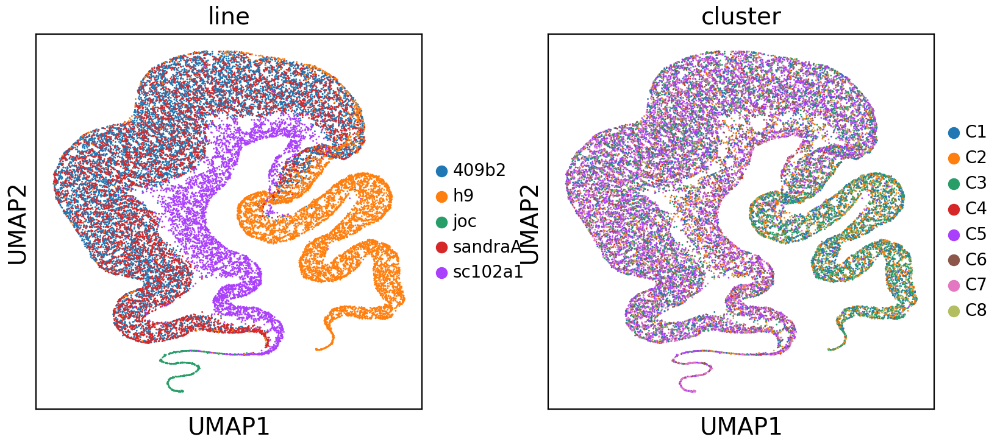

In [26]:
sc.pp.neighbors(adata_check, n_neighbors=30, n_pcs=4)
sc.tl.umap(adata_check)
sc.pl.umap(adata_check, color=['line', 'cluster'], alpha=1.)
fig.savefig(config.PATHS.APPENDIX/'umap_lda_reduced')

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:21)


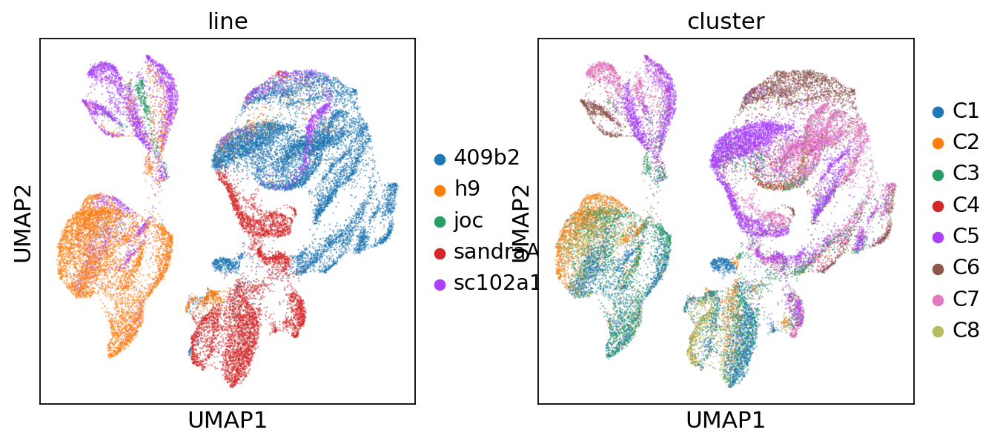

In [43]:
sc.pp.pca(
    adata_check, n_comps=20, use_highly_variable=True, 
    svd_solver='arpack')
sc.pp.neighbors(
    adata_check, n_neighbors=80, 
    n_pcs=20, use_rep="X_pca",
    key_added="{}".format(config.PROTO.INTEGRATE.TYPE))
sc.tl.umap(
    adata_check, neighbors_key="{}".format(config.PROTO.INTEGRATE.TYPE),
    random_state=config.PROTO.SEED)
sc.pl.umap(adata_check, color=['line', 'cluster'], alpha=.5)

In [ ]:
del adata_check

# Integration with Harmony

computing PCA
    on highly variable genes
    with n_comps=32
    finished (0:00:19)


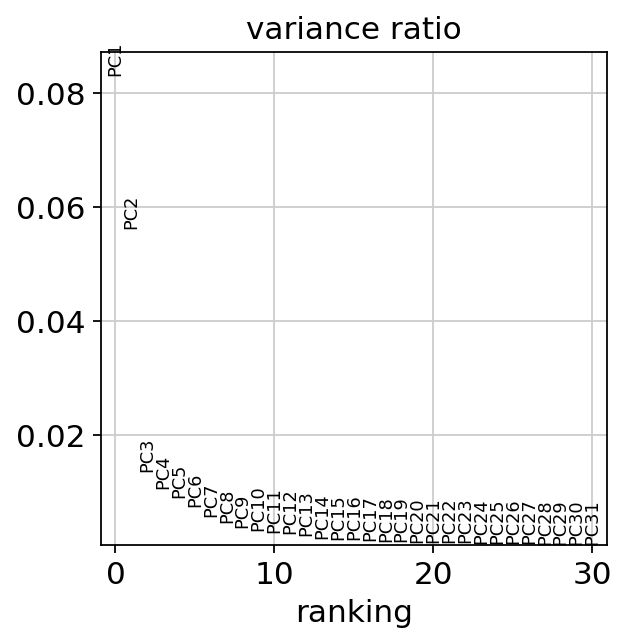

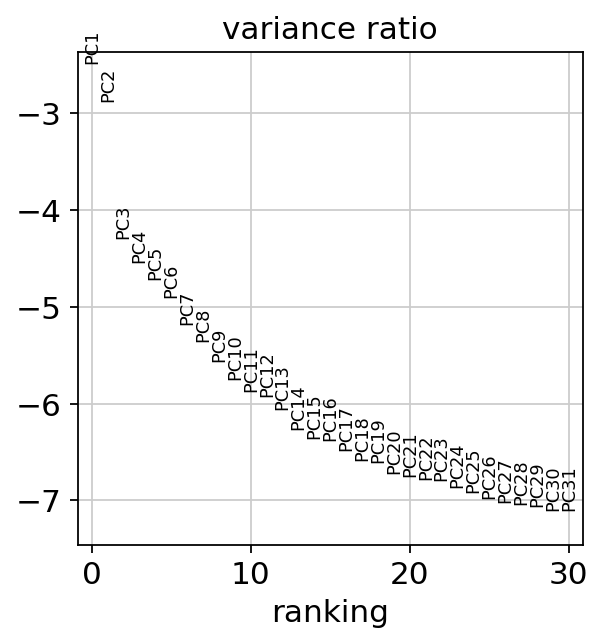

In [6]:
sc.pp.pca(
    adata, n_comps=32, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata)
sc.pl.pca_variance_ratio(adata, log=True)

## Performing correction with Harmony

Harmony uses an iterative clustering approach to align cells from different batches. For each iteration:

    soft k-means clustering to group cells from multiple datasets
    computation for each cluster of a global centroid and a dataset-specific centroid
    from the centroids, calculation of a correction factor
    the correction factor is used to correct each cell with a cell-specific factor


In [7]:
tmp = adata.obsm['X_pca'].copy()
nPCA = 19
adata.obsm['X_pca'] = adata.obsm['X_pca'][..., :nPCA]

In [8]:
if config.PROTO.INTEGRATE.TYPE == 'harmony':
    sc.external.pp.harmony_integrate(adata, config.PROTO.INTEGRATE.FIELD)
elif config.PROTO.INTEGRATE.TYPE == 'scanorama':
    # make batches contiguous
    idx = adata.obs.sort_values("line").index
    adata = adata[idx,]
    sce.pp.scanorama_integrate(adata, config.PROTO.INTEGRATE.FIELD)

2024-01-19 02:58:36,716 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-01-19 02:58:41,196 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-19 02:58:41,416 - harmonypy - INFO - Iteration 1 of 10
2024-01-19 02:58:59,159 - harmonypy - INFO - Iteration 2 of 10
2024-01-19 02:59:17,782 - harmonypy - INFO - Iteration 3 of 10
2024-01-19 02:59:38,436 - harmonypy - INFO - Iteration 4 of 10
2024-01-19 02:59:57,500 - harmonypy - INFO - Iteration 5 of 10
2024-01-19 03:00:17,409 - harmonypy - INFO - Converged after 5 iterations


## Repeat plot with batch-corrected PCA

New corrected PC are saved in .obs["X_pca_harmony"]

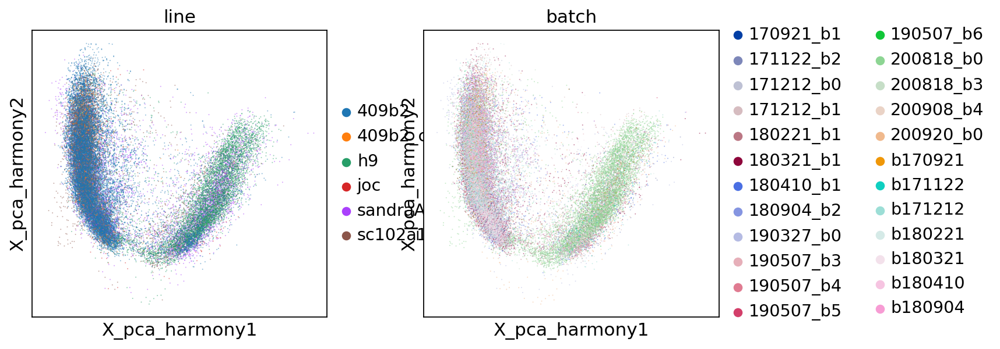

In [9]:
sc.pl.embedding(
    adata, basis="X_pca_{}".format(config.PROTO.INTEGRATE.TYPE),
    color=['line', 'batch'], alpha=.5)

# Calculate dimensionality reductions

In [10]:
adata.obsm["X_pca_{}".format(config.PROTO.INTEGRATE.TYPE)] = np.concatenate(
    [adata.obsm["X_pca_{}".format(config.PROTO.INTEGRATE.TYPE)], tmp[..., nPCA:]], -1)

In [11]:
sc.pp.neighbors(
    adata, n_neighbors=80,
    n_pcs=nPCA, use_rep="X_pca_{}".format(config.PROTO.INTEGRATE.TYPE),
    key_added="{}".format(config.PROTO.INTEGRATE.TYPE), 
    # metric='cosine',
)
#sc.pp.neighbors(adata, n_neighbors=80, n_pcs=15, use_rep="X_pca_harmony", key_added="harmony", )

computing neighbors
    finished: added to `.uns['harmony']`
    `.obsp['harmony_distances']`, distances for each pair of neighbors
    `.obsp['harmony_connectivities']`, weighted adjacency matrix (0:01:04)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:31)


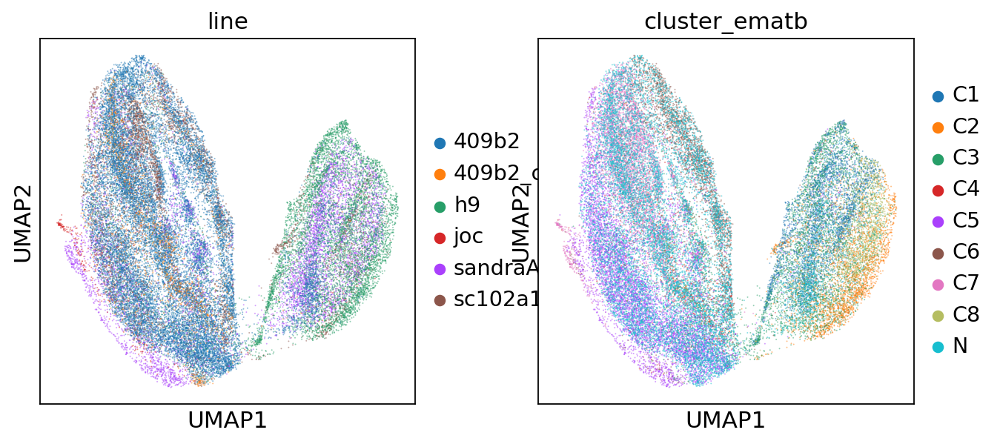

In [12]:
sc.tl.umap(
    adata, neighbors_key="{}".format(config.PROTO.INTEGRATE.TYPE),
    random_state=config.PROTO.SEED)
sc.pl.umap(adata, color=['line', 'cluster_ematb'], alpha=.5)

In [13]:
ematb_neighbours = 12

for idx in np.where(adata.obs.dataset == 'MEDELEY')[0]:
    neighbours = adata.obsp['harmony_connectivities'][idx]

    ematb_idxs = np.where(adata.obs.dataset == 'EMATB')[0]
    tmp = np.where(neighbours.toarray()[0])[0]
    intersected = set(tmp).intersection(ematb_idxs)

    assert len(intersected) >= ematb_neighbours

    adata.obs.iloc[idx, adata.obs.columns.get_loc('cluster')] = adata.obs.iloc[
        list(intersected)].cluster.mode()[0]

    distances = adata.obsp['harmony_distances'][idx]
    distances = sorted(distances.toarray()[0][list(intersected)])
    min_dist = distances[0]

    distances = min_dist / np.array(distances)
    distances /= distances.sum()

    for i in range(1, 3):
        adata.obs.iloc[idx, adata.obs.columns.get_loc('tSNE_{}'.format(i))] = (
            adata.obs.iloc[
                list(intersected)][
                'tSNE_{}'.format(i)
            ].mode() * distances).sum()


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:31)


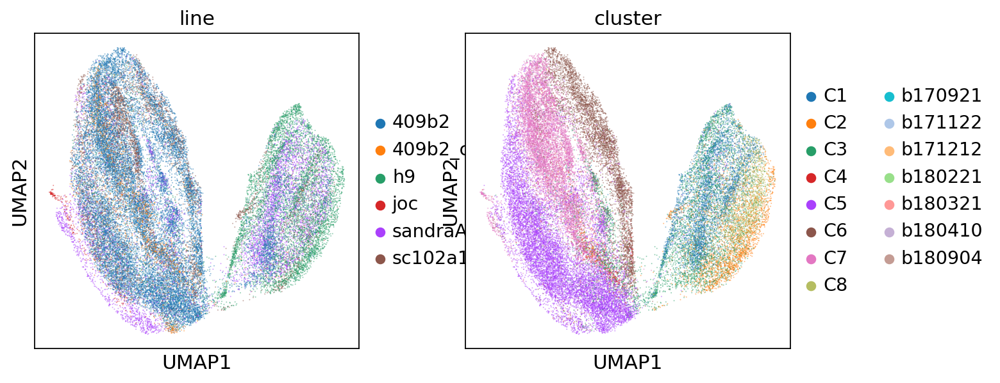

In [14]:
sc.tl.umap(
    adata, neighbors_key="{}".format(config.PROTO.INTEGRATE.TYPE),
    random_state=config.PROTO.SEED)
sc.pl.umap(adata, color=['line', 'cluster'], alpha=.5)

In [37]:
# Calculate the Diffusion Map
sc.tl.diffmap(
    adata, neighbors_key="{}".format(config.PROTO.INTEGRATE.TYPE))

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9971422  0.9904049  0.9809257  0.97178924 0.96599454
     0.9634147  0.95747197 0.95377415 0.9502475  0.9489006  0.94633925
     0.94281596 0.937121   0.9366284 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:03)


In [155]:
# Calculate the Force-directed graph

#Takes quite some time 
sc.tl.draw_graph(
    adata, neighbors_key="{}".format(config.PROTO.INTEGRATE.TYPE))

drawing single-cell graph using layout 'fa'


KeyboardInterrupt: 

# Visualize UMAP

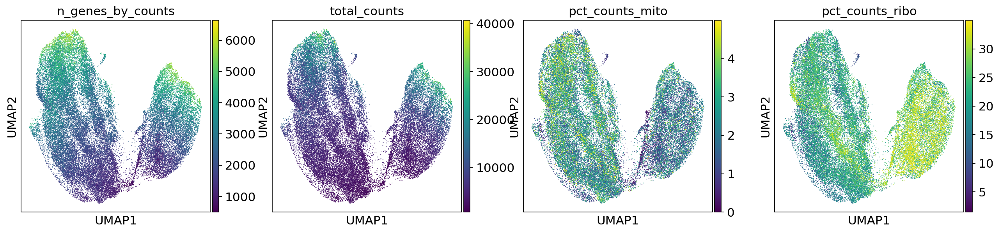

In [156]:
sc.pl.umap(
    adata, color=[
        'n_genes_by_counts',"total_counts", 
        'pct_counts_mito', 'pct_counts_ribo'])

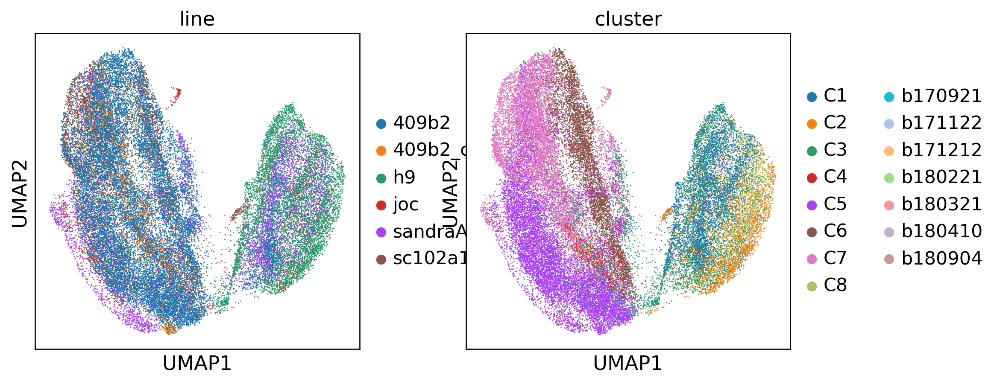

In [157]:
sc.settings.set_figure_params(dpi=120)
sc.pl.umap(adata, color=['line', 'cluster'])

# Visualize Diffusion Map

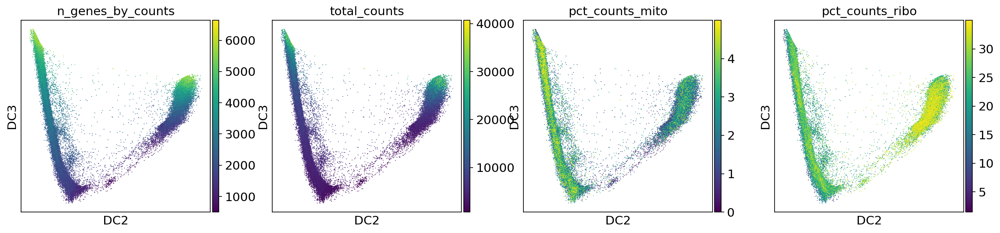

In [159]:
sc.settings.set_figure_params(dpi=80)
sc.pl.diffmap(adata, color=['n_genes_by_counts',"total_counts", 'pct_counts_mito', 'pct_counts_ribo'], 
             components=['2,3'])

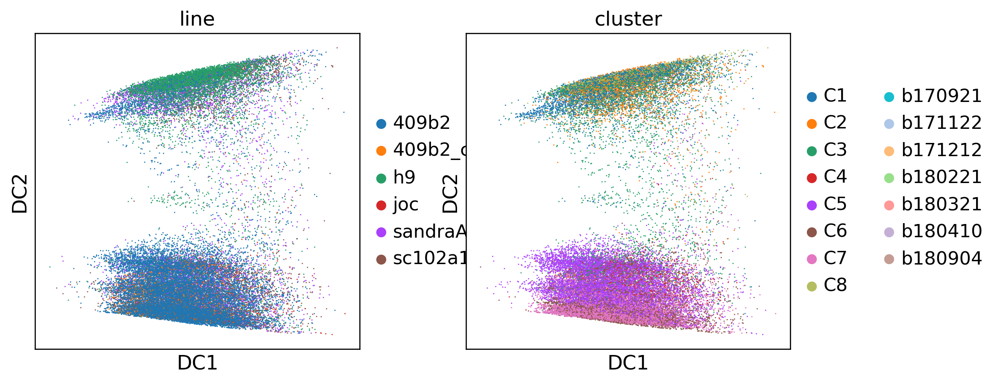

In [160]:
sc.settings.set_figure_params(dpi=120)
sc.pl.diffmap(adata, color=['line', 'cluster'], components=['1,2'])

# Visualize Force-directed graph

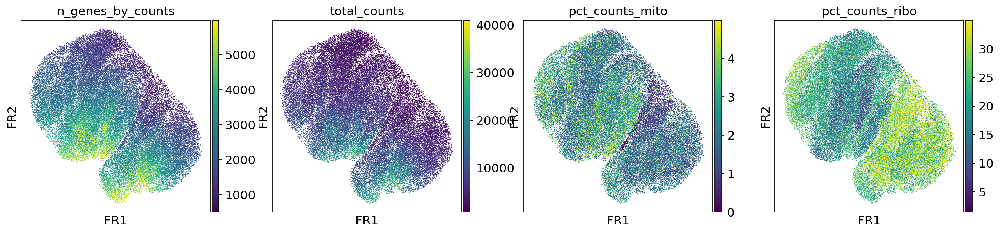

In [19]:
sc.settings.set_figure_params(dpi=80)
sc.pl.draw_graph(adata, color=[
    'n_genes_by_counts',"total_counts", 'pct_counts_mito', 
    'pct_counts_ribo'])

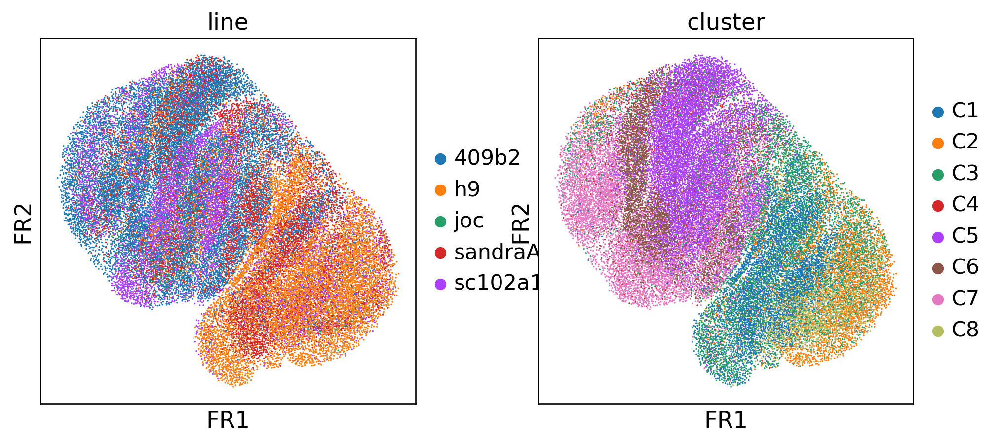

In [20]:
sc.settings.set_figure_params(dpi=120)
sc.pl.draw_graph(adata, color=['line', 'cluster'], alpha=1)

# Cell population markers
Functions for plotting markers in UMAP

In [162]:
def selectMarkers(adataObj, mList):
    """  From a list of gene names select only the genes that are present in adata.var
    """
    #Select markers present in adata
    p = adataObj.var_names[adataObj.var_names.isin(mList) == True]
    #Keep the same order as input list
    p = [x for x in mList if x in p]   
    
    #Select missing genes
    ab = set(mList).difference(set(adataObj.var_names))
    
    #Print message
    if len(ab) == len(mList):
        print('\nAll markers are missing')
    else:
        print('\nThe following marker genes are missing: ', ab)
        
    return(p)

def CustomUmap(adata, genes):
    genes = selectMarkers(adata, genes)
    sc.pl.umap(adata, color=genes, size=10, frameon=False,
               vmin='p1',  vmax='p99', layer='lognormcounts')


The following marker genes are missing:  set()


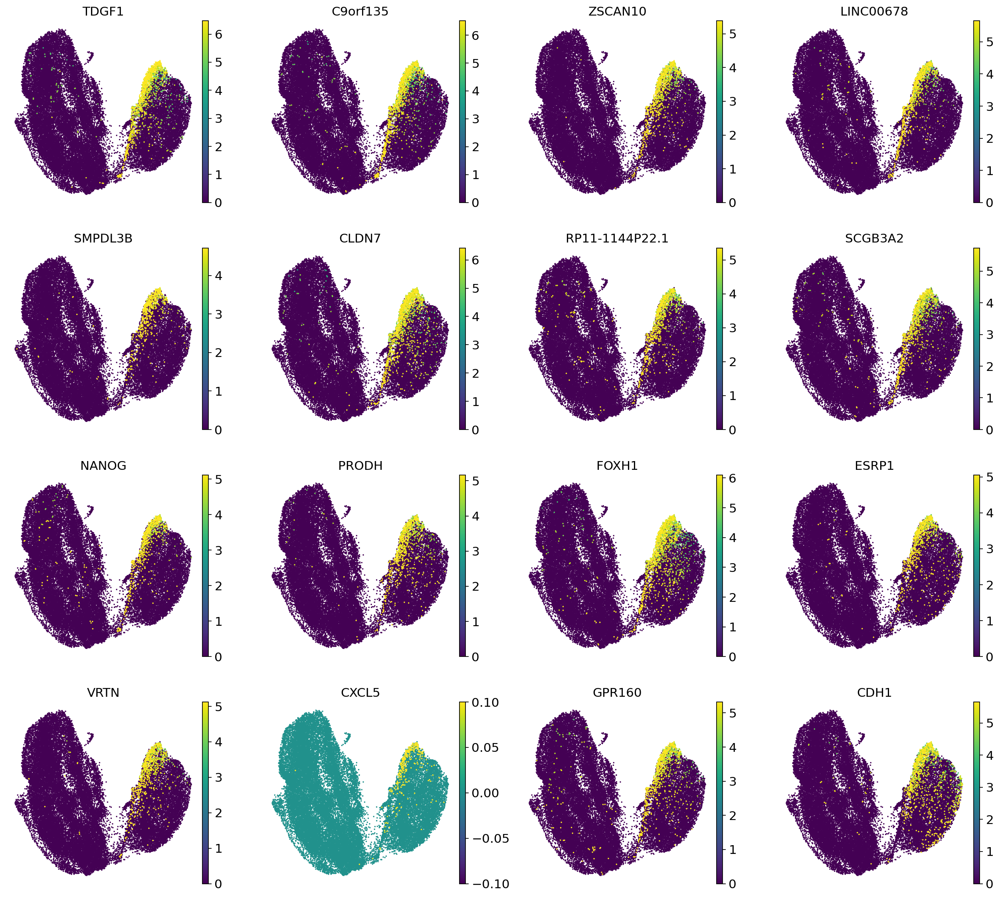

In [163]:
# Top Triku genes

TopTriku = adata.var.sort_values(by=['triku_distance'], ascending=False).head(16).index
CustomUmap(adata, TopTriku)

In [164]:
# Dictionary of marker genes

marker_dictionary = {
    'Proliferation': ['MKI67', 'CDC20', 'HMGB2', 'CCNB1'], 
    'Apical Progenitors': ['FABP7', 'GLI3', 'PAX6', 'NES', 'SOX1', 'SOX2', 'SOX9', 'VIM'], 
    'Intermediate Progenitors': ['EOMES', 'ELAVL4', 'NHLH1', 'KCNQ3'], 
    'Pan-neuronal': ['DCX', 'STMN2', 'SYT1', 'SYP', 'GAP43', 'MEF2C',  'FOXG1'], 
    'ExcitatoryNeurons': ['EMX1', 'NEUROD1', 'NEUROD2', 'NEUROD6', 'NEUROG2', 'SLC17A7', 'TBR1', 'BCL11A', 'CUX1', 'CUX2', 'SATB2'], 
    'Inhibitory Neurons': ['DLX5', 'DLX6', 'DLX6-AS1', 'GAD1', 'GAD2', 'NKX2.1', 'SST', 'NPY', 'CALB1', 'CALB2', 'VIP', 'PVALB'], 
    'oRG': ['FAM107A', 'HOPX',  'PTPRZ1', 'TNC'], 
    'Astrocytes': ['GFAP', 'SLC1A3',  'S100B', 'AQP4', 'FGFR3', 'ALDH1L1']
    }



 Proliferation

The following marker genes are missing:  set()


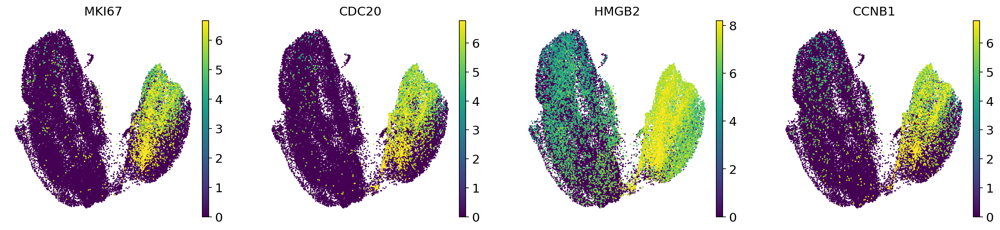



 Apical Progenitors

The following marker genes are missing:  set()


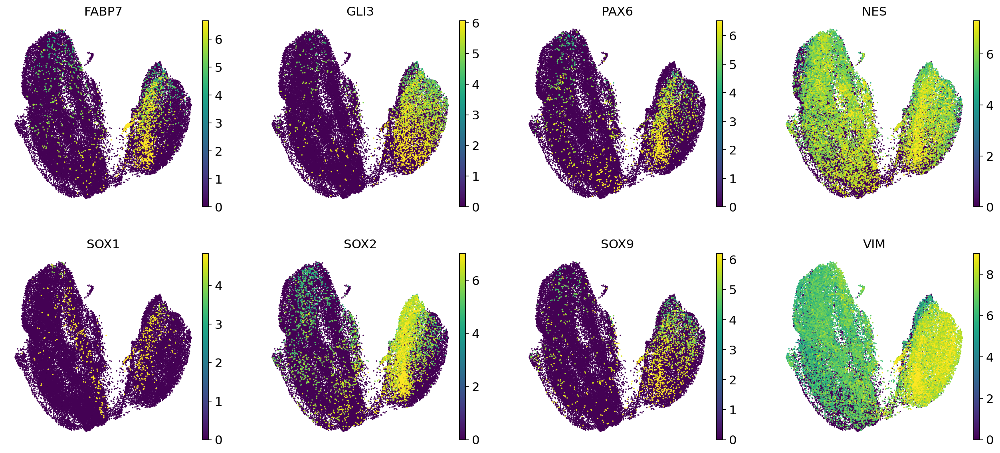



 Intermediate Progenitors

The following marker genes are missing:  {'EOMES'}


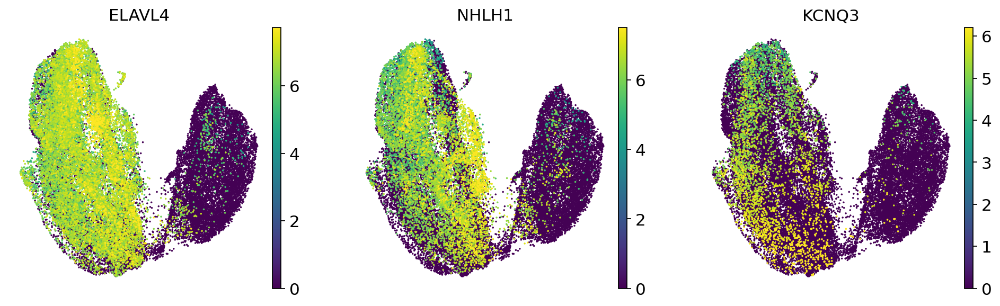



 Pan-neuronal

The following marker genes are missing:  {'FOXG1'}


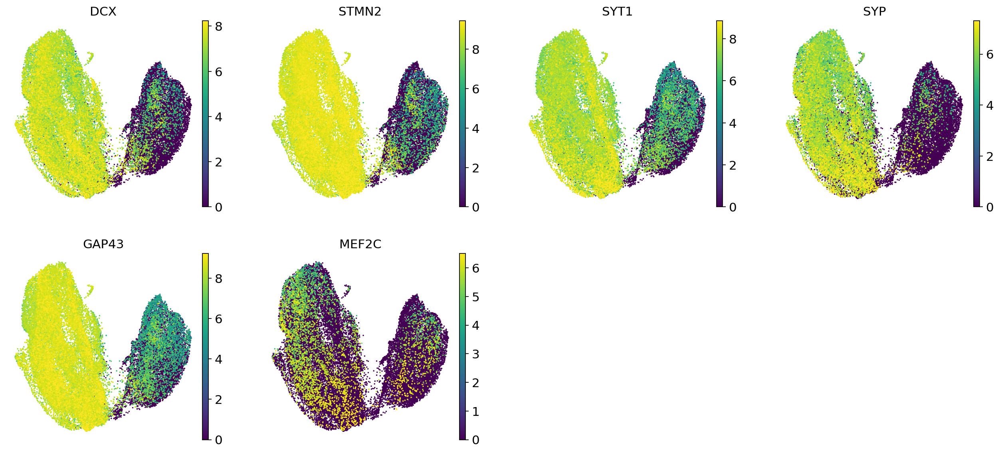



 ExcitatoryNeurons

The following marker genes are missing:  {'TBR1', 'EMX1', 'NEUROD6', 'CUX1', 'SATB2', 'CUX2'}


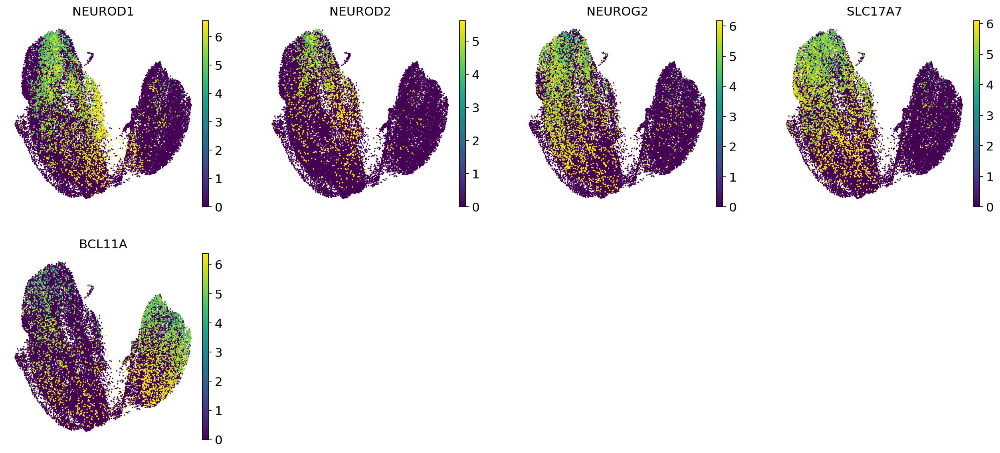



 Inhibitory Neurons

The following marker genes are missing:  {'DLX6', 'DLX6-AS1', 'NKX2.1', 'NPY', 'DLX5', 'GAD1', 'VIP'}


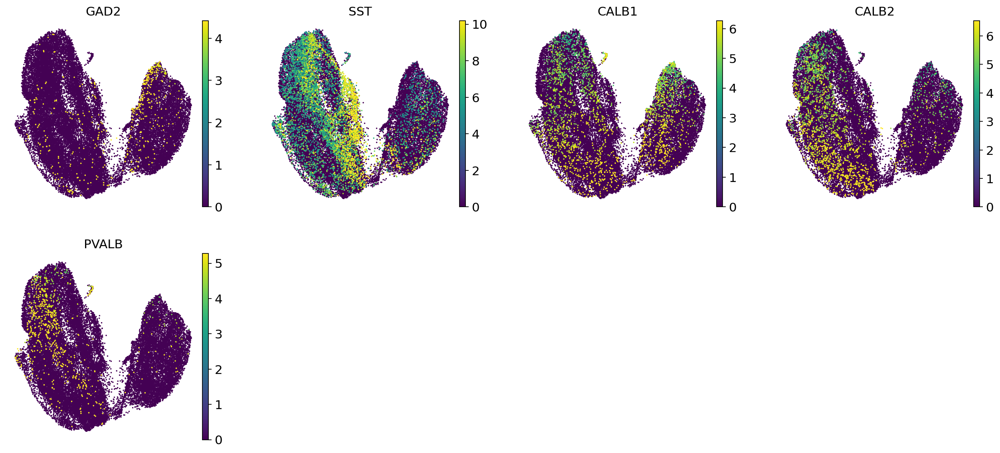



 oRG

The following marker genes are missing:  {'FAM107A'}


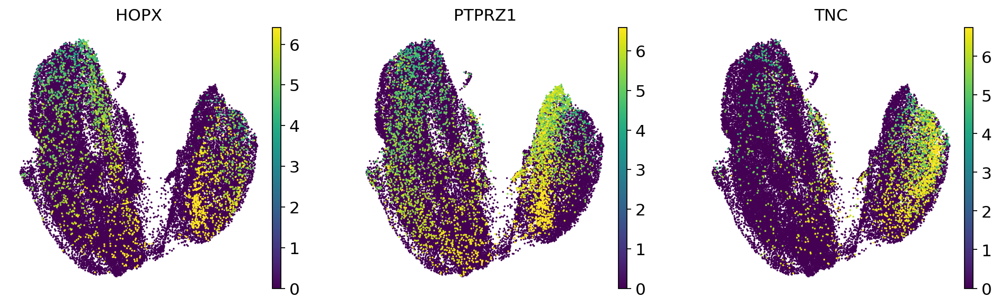



 Astrocytes

The following marker genes are missing:  {'GFAP', 'AQP4', 'ALDH1L1'}


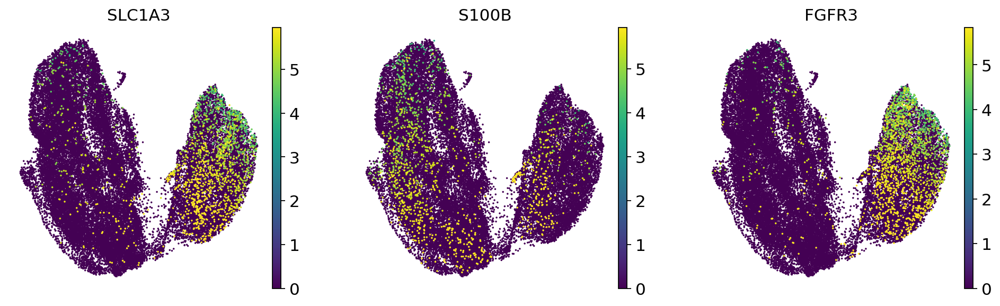

In [165]:
# Marker gene plotting

for Pop in marker_dictionary: 
    print("\n\n {}".format(Pop)) 
    CustomUmap(adata, marker_dictionary[Pop])

# Save

In [16]:
adata.write(config.PATHS.LOGS/'Reduced.h5ad')
print(datetime.now() - time_start)

0:08:21.591871
